# <center> **NLP analysis of jokes dataset**

## Table of Contents

1. **[Functions](#1)**
2. **[General EDA](#2)**
	* [Analyzing Text Statistics](#sub-heading1)
3. **[Text Data Preprocessing](#3)**
	* [Cleaning](#sub-heading2)

In [2]:
!pip install unidecode
!pip install emoji
!pip install word2number
!pip install contractions
!pip3 install spacy
!python3 -m spacy download en_core_web_sm
!python3 -m nltk.downloader stopwords
!pip install pyspellchecker
!pip install iplot

     |████████████████████████████████| 235 kB 5.3 MB/s 
     |████████████████████████████████| 174 kB 5.4 MB/s 
  Created wheel for emoji: filename=emoji-1.6.3-py3-none-any.whl size=170298 sha256=31be85553f1d7ba9380a48d8b653960fee50bfcb3e22310981b3d0ddb472f4c3
  Stored in directory: /root/.cache/pip/wheels/03/8b/d7/ad579fbef83c287215c0caab60fb0ae0f30c4d7ce5f580eade
Successfully built emoji
  Created wheel for word2number: filename=word2number-1.1-py3-none-any.whl size=5582 sha256=aa1780ec41da291b4fa61eb412ec12021c892a0d0b0154c28a2ecce311922c48
  Stored in directory: /root/.cache/pip/wheels/4b/c3/77/a5f48aeb0d3efb7cd5ad61cbd3da30bbf9ffc9662b07c9f879
Successfully built word2number
     |████████████████████████████████| 321 kB 5.4 MB/s 
     |████████████████████████████████| 284 kB 51.3 MB/s 
  Created wheel for pyahocorasick: filename=pyahocorasick-1.4.2-cp37-cp37m-linux_x86_64.whl size=85449 sha256=02dc2c712d7f73235251c97db62297e0c8ba98220d5810208facdae85db31cd0
  Stored in director

In [3]:
import pandas as pd
import numpy as np
import re
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

from scipy.stats import norm

from google.colab import drive
import os
import string
import emoji

import plotly as py
import numpy as np
from plotly.offline import init_notebook_mode, iplot
from plotly.graph_objs import Contours, Histogram2dContour, Marker, Scatter

import unidecode
from word2number import w2n
import contractions
from bs4 import BeautifulSoup
import spacy

import nltk
nltk.download('punkt')
nltk.download('wordnet')
from nltk.corpus import wordnet
from nltk.stem import WordNetLemmatizer
nltk.download('averaged_perceptron_tagger')
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from collections import Counter
from spellchecker import SpellChecker
from wordcloud import WordCloud

from tqdm._tqdm_notebook import tqdm_notebook
tqdm_notebook.pandas(desc='PROGRESS>>>')

from google_drive_downloader import GoogleDriveDownloader as gdd
from IPython.core.display import display, HTML

from sklearn.model_selection import RepeatedStratifiedKFold, GridSearchCV, StratifiedKFold, KFold, cross_val_score, train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn import metrics
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import label_binarize, StandardScaler

from torch.optim.lr_scheduler import CosineAnnealingLR
from tqdm import tqdm
import gensim
import gensim.downloader as api
from gensim.models import Word2Vec

import gensim.downloader as gensim_api
from torch.nn.utils.rnn import pad_sequence

from functools import partial
import torch   
# from torchtext import data    
import torch.nn as nn
from torch.utils.data import TensorDataset, ConcatDataset, DataLoader, random_split, Dataset
import torch.nn.functional as F
import torchvision.transforms as transforms
import torchvision
import torch.optim as optim

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Unzipping taggers/averaged_perceptron_tagger.zip.


In [82]:
import cufflinks as cf
cf.go_offline()
cf.set_config_file(offline=False, world_readable=True)
import plotly.graph_objs as go

In [4]:
drive.mount("/content/drive")

Mounted at /content/drive


In [61]:
df = pd.read_csv('/content/drive/My Drive/NLP_humor/data/jokes_dataset.csv', 
                 sep=',', 
                 encoding='utf-8').set_index('id')

# **Functions**

In [8]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

**Activate Plotly**

In [9]:
def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

**Word clouds**

In [10]:
def draw_word_clouds(data):
  fig, (ax1) = plt.subplots(1, 1, figsize=[26, 8])
  wordcloud1 = WordCloud( background_color='white',
                          width=600,
                          height=400).generate(" ".join(data['joke']))
  ax1.imshow(wordcloud1)
  ax1.axis('off')
  ax1.set_title('Joke',fontsize=40);

**Top words**

In [11]:
def draw_top_words(data, top_size, title):
  counting_table = pd.DataFrame(count_words(data, top_size))
  counting_table.drop([0],inplace=True)
  counting_table.columns = ['word','counting']

  plt.figure(figsize=(17,10))
  ax= sns.barplot(data=counting_table,x='word',y='counting',facecolor=(1, 1, 1, 0),edgecolor='black')
  if title == 'Top' or title == 'top':
    ax.set_title(f'Top {top_size} words'.title(),fontsize=20)
  else:
    ax.set_title(f'{title} words: Top {top_size}'.title(),fontsize=20)

  ax.set_ylabel('Word counting',fontsize=15)
  ax.set_xlabel(f'Top {top_size} words',fontsize=15);
  plt.xticks(rotation=45)
  plt.show()

**Removal of html tags**

In [12]:
def strip_html_tags(text):
    """remove html tags from text"""
    soup = BeautifulSoup(text, "html.parser")
    stripped_text = soup.get_text(separator=" ")
    return stripped_text

**Removal of whitespaces**

In [13]:
def remove_whitespace(text):
    """remove extra whitespaces from text"""
    text = text.strip()
    return " ".join(text.split())

**Removal of accented characters**

In [14]:
def remove_accented_chars(text):
    """remove accented characters from text, e.g. café"""
    text = unidecode.unidecode(text)
    return text

**Removal of shortened words**

In [15]:
def expand_contractions(text):
    """expand shortened words, e.g. don't to do not"""
    text = contractions.fix(text)
    return text

**Removal of urls**

In [16]:
def find_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.findall(text)

In [17]:
def remove_urls(text):
    url_pattern = re.compile(r'https?://\S+|www\.\S+')
    return url_pattern.sub(r'', text)

**Removal of Frequent words**

In [18]:
def count_words(text, top=10):
    cnt = Counter()
    for text in text.values:
        for word in text.split():
            cnt[word] += 1
          
    return cnt.most_common(top)

In [19]:
# FREQWORDS = set([w for (w, wc) in count_words(data['joke'], 10)])
# FREQWORDS

# n_rare_words = 10
# RAREWORDS = set([w for (w, wc) in count_words(data['joke'][:-n_rare_words-1:-1])])
# RAREWORDS

In [20]:
def remove_freqwords(text):
    """remove the frequent words"""
    return " ".join([word for word in str(text).split() if word not in FREQWORDS])

**Removal of Rare words**

In [21]:
def remove_rarewords(text):
    """remove the rare words"""
    return " ".join([word for word in str(text).split() if word not in RAREWORDS])

**Removal of stopwords**


In [22]:
STOPWORDS = set(stopwords.words('english'))

def remove_stopwords(text):
    """remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

**Convert chat words**

In [23]:
chat_words_str = """
AFAIK=As Far As I Know
AFK=Away From Keyboard
ASAP=As Soon As Possible
ATK=At The Keyboard
ATM=At The Moment
A3=Anytime, Anywhere, Anyplace
BAK=Back At Keyboard
BBL=Be Back Later
BBS=Be Back Soon
BFN=Bye For Now
B4N=Bye For Now
BRB=Be Right Back
BRT=Be Right There
BTW=By The Way
B4=Before
B4N=Bye For Now
CU=See You
CUL8R=See You Later
CYA=See You
FAQ=Frequently Asked Questions
FC=Fingers Crossed
FWIW=For What It's Worth
FYI=For Your Information
GAL=Get A Life
GG=Good Game
GN=Good Night
GMTA=Great Minds Think Alike
GR8=Great!
G9=Genius
IC=I See
ICQ=I Seek you (also a chat program)
ILU=ILU: I Love You
IMHO=In My Honest/Humble Opinion
IMO=In My Opinion
IOW=In Other Words
IRL=In Real Life
LDR=Long Distance Relationship
LMAO=Laugh My A.. Off
LOL=Laughing Out Loud
LTNS=Long Time No See
L8R=Later
MTE=My Thoughts Exactly
M8=Mate
NRN=No Reply Necessary
OIC=Oh I See
PITA=Pain In The A..
PRT=Party
PRW=Parents Are Watching
ROFL=Rolling On The Floor Laughing
ROFLOL=Rolling On The Floor Laughing Out Loud
ROTFLMAO=Rolling On The Floor Laughing My A.. Off
SK8=Skate
STATS=Your sex and age
ASL=Age, Sex, Location
THX=Thank You
TTFN=Ta-Ta For Now!
TTYL=Talk To You Later
U=You
U2=You Too
U4E=Yours For Ever
WB=Welcome Back
WTF=What The F...
WTG=Way To Go!
WUF=Where Are You From?
W8=Wait...
7K=Sick:-D Laugher
"""

In [24]:
def chat_words_conversion(text):
    new_text = []
    for w in text.split():
        if w.upper() in chat_words_list:
            new_text.append(chat_words_map_dict[w.upper()])
        else:
            new_text.append(w)
    return " ".join(new_text)

**Convertion of emoticons**

In [25]:
EMOTICONS = {
    u":‑\)":"Happy face or smiley",
    u":\)":"Happy face or smiley",
    u":-\]":"Happy face or smiley",
    u":\]":"Happy face or smiley",
    u":-3":"Happy face smiley",
    u":3":"Happy face smiley",
    u":->":"Happy face smiley",
    u":>":"Happy face smiley",
    u"8-\)":"Happy face smiley",
    u":o\)":"Happy face smiley",
    u":-\}":"Happy face smiley",
    u":\}":"Happy face smiley",
    u":-\)":"Happy face smiley",
    u":c\)":"Happy face smiley",
    u":\^\)":"Happy face smiley",
    u"=\]":"Happy face smiley",
    u"=\)":"Happy face smiley",
    u":‑D":"Laughing, big grin or laugh with glasses",
    u":D":"Laughing, big grin or laugh with glasses",
    u"8‑D":"Laughing, big grin or laugh with glasses",
    u"8D":"Laughing, big grin or laugh with glasses",
    u"X‑D":"Laughing, big grin or laugh with glasses",
    u"XD":"Laughing, big grin or laugh with glasses",
    u"=D":"Laughing, big grin or laugh with glasses",
    u"=3":"Laughing, big grin or laugh with glasses",
    u"B\^D":"Laughing, big grin or laugh with glasses",
    u":-\)\)":"Very happy",
    u":‑\(":"Frown, sad, andry or pouting",
    u":-\(":"Frown, sad, andry or pouting",
    u":\(":"Frown, sad, andry or pouting",
    u":‑c":"Frown, sad, andry or pouting",
    u":c":"Frown, sad, andry or pouting",
    u":‑<":"Frown, sad, andry or pouting",
    u":<":"Frown, sad, andry or pouting",
    u":‑\[":"Frown, sad, andry or pouting",
    u":\[":"Frown, sad, andry or pouting",
    u":-\|\|":"Frown, sad, andry or pouting",
    u">:\[":"Frown, sad, andry or pouting",
    u":\{":"Frown, sad, andry or pouting",
    u":@":"Frown, sad, andry or pouting",
    u">:\(":"Frown, sad, andry or pouting",
    u":'‑\(":"Crying",
    u":'\(":"Crying",
    u":'‑\)":"Tears of happiness",
    u":'\)":"Tears of happiness",
    u"D‑':":"Horror",
    u"D:<":"Disgust",
    u"D:":"Sadness",
    u"D8":"Great dismay",
    u"D;":"Great dismay",
    u"D=":"Great dismay",
    u"DX":"Great dismay",
    u":‑O":"Surprise",
    u":O":"Surprise",
    u":‑o":"Surprise",
    u":o":"Surprise",
    u":-0":"Shock",
    u"8‑0":"Yawn",
    u">:O":"Yawn",
    u":-\*":"Kiss",
    u":\*":"Kiss",
    u":X":"Kiss",
    u";‑\)":"Wink or smirk",
    u";\)":"Wink or smirk",
    u"\*-\)":"Wink or smirk",
    u"\*\)":"Wink or smirk",
    u";‑\]":"Wink or smirk",
    u";\]":"Wink or smirk",
    u";\^\)":"Wink or smirk",
    u":‑,":"Wink or smirk",
    u";D":"Wink or smirk",
    u":‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"X‑P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"XP":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":Þ":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"d:":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"=p":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u">:P":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u":‑/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":-[.]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u">:/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=/":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=[(\\\)]":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u"=L":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":S":"Skeptical, annoyed, undecided, uneasy or hesitant",
    u":‑\|":"Straight face",
    u":\|":"Straight face",
    u":$":"Embarrassed or blushing",
    u":‑x":"Sealed lips or wearing braces or tongue-tied",
    u":x":"Sealed lips or wearing braces or tongue-tied",
    u":‑#":"Sealed lips or wearing braces or tongue-tied",
    u":#":"Sealed lips or wearing braces or tongue-tied",
    u":‑&":"Sealed lips or wearing braces or tongue-tied",
    u":&":"Sealed lips or wearing braces or tongue-tied",
    u"O:‑\)":"Angel, saint or innocent",
    u"O:\)":"Angel, saint or innocent",
    u"0:‑3":"Angel, saint or innocent",
    u"0:3":"Angel, saint or innocent",
    u"0:‑\)":"Angel, saint or innocent",
    u"0:\)":"Angel, saint or innocent",
    u":‑b":"Tongue sticking out, cheeky, playful or blowing a raspberry",
    u"0;\^\)":"Angel, saint or innocent",
    u">:‑\)":"Evil or devilish",
    u">:\)":"Evil or devilish",
    u"\}:‑\)":"Evil or devilish",
    u"\}:\)":"Evil or devilish",
    u"3:‑\)":"Evil or devilish",
    u"3:\)":"Evil or devilish",
    u">;\)":"Evil or devilish",
    u"\|;‑\)":"Cool",
    u"\|‑O":"Bored",
    u":‑J":"Tongue-in-cheek",
    u"#‑\)":"Party all night",
    u"%‑\)":"Drunk or confused",
    u"%\)":"Drunk or confused",
    u":-###..":"Being sick",
    u":###..":"Being sick",
    u"<:‑\|":"Dump",
    u"\(>_<\)":"Troubled",
    u"\(>_<\)>":"Troubled",
    u"\(';'\)":"Baby",
    u"\(\^\^>``":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(\^_\^;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(~_~;\) \(・\.・;\)":"Nervous or Embarrassed or Troubled or Shy or Sweat drop",
    u"\(-_-\)zzz":"Sleeping",
    u"\(\^_-\)":"Wink",
    u"\(\(\+_\+\)\)":"Confused",
    u"\(\+o\+\)":"Confused",
    u"\(o\|o\)":"Ultraman",
    u"\^_\^":"Joyful",
    u"\(\^_\^\)/":"Joyful",
    u"\(\^O\^\)／":"Joyful",
    u"\(\^o\^\)／":"Joyful",
    u"\(__\)":"Kowtow as a sign of respect, or dogeza for apology",
    u"_\(\._\.\)_":"Kowtow as a sign of respect, or dogeza for apology",
    u"<\(_ _\)>":"Kowtow as a sign of respect, or dogeza for apology",
    u"<m\(__\)m>":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(__\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"m\(_ _\)m":"Kowtow as a sign of respect, or dogeza for apology",
    u"\('_'\)":"Sad or Crying",
    u"\(/_;\)":"Sad or Crying",
    u"\(T_T\) \(;_;\)":"Sad or Crying",
    u"\(;_;":"Sad of Crying",
    u"\(;_:\)":"Sad or Crying",
    u"\(;O;\)":"Sad or Crying",
    u"\(:_;\)":"Sad or Crying",
    u"\(ToT\)":"Sad or Crying",
    u";_;":"Sad or Crying",
    u";-;":"Sad or Crying",
    u";n;":"Sad or Crying",
    u";;":"Sad or Crying",
    u"Q\.Q":"Sad or Crying",
    u"T\.T":"Sad or Crying",
    u"QQ":"Sad or Crying",
    u"Q_Q":"Sad or Crying",
    u"\(-\.-\)":"Shame",
    u"\(-_-\)":"Shame",
    u"\(一一\)":"Shame",
    u"\(；一_一\)":"Shame",
    u"\(=_=\)":"Tired",
    u"\(=\^\·\^=\)":"cat",
    u"\(=\^\·\·\^=\)":"cat",
    u"=_\^=	":"cat",
    u"\(\.\.\)":"Looking down",
    u"\(\._\.\)":"Looking down",
    u"\^m\^":"Giggling with hand covering mouth",
    u"\(\・\・?":"Confusion",
    u"\(?_?\)":"Confusion",
    u">\^_\^<":"Normal Laugh",
    u"<\^!\^>":"Normal Laugh",
    u"\^/\^":"Normal Laugh",
    u"\（\*\^_\^\*）" :"Normal Laugh",
    u"\(\^<\^\) \(\^\.\^\)":"Normal Laugh",
    u"\(^\^\)":"Normal Laugh",
    u"\(\^\.\^\)":"Normal Laugh",
    u"\(\^_\^\.\)":"Normal Laugh",
    u"\(\^_\^\)":"Normal Laugh",
    u"\(\^\^\)":"Normal Laugh",
    u"\(\^J\^\)":"Normal Laugh",
    u"\(\*\^\.\^\*\)":"Normal Laugh",
    u"\(\^—\^\）":"Normal Laugh",
    u"\(#\^\.\^#\)":"Normal Laugh",
    u"\（\^—\^\）":"Waving",
    u"\(;_;\)/~~~":"Waving",
    u"\(\^\.\^\)/~~~":"Waving",
    u"\(-_-\)/~~~ \($\·\·\)/~~~":"Waving",
    u"\(T_T\)/~~~":"Waving",
    u"\(ToT\)/~~~":"Waving",
    u"\(\*\^0\^\*\)":"Excited",
    u"\(\*_\*\)":"Amazed",
    u"\(\*_\*;":"Amazed",
    u"\(\+_\+\) \(@_@\)":"Amazed",
    u"\(\*\^\^\)v":"Laughing,Cheerful",
    u"\(\^_\^\)v":"Laughing,Cheerful",
    u"\(\(d[-_-]b\)\)":"Headphones,Listening to music",
    u'\(-"-\)':"Worried",
    u"\(ーー;\)":"Worried",
    u"\(\^0_0\^\)":"Eyeglasses",
    u"\(\＾ｖ\＾\)":"Happy",
    u"\(\＾ｕ\＾\)":"Happy",
    u"\(\^\)o\(\^\)":"Happy",
    u"\(\^O\^\)":"Happy",
    u"\(\^o\^\)":"Happy",
    u"\)\^o\^\(":"Happy",
    u":O o_O":"Surprised",
    u"o_0":"Surprised",
    u"o\.O":"Surpised",
    u"\(o\.o\)":"Surprised",
    u"oO":"Surprised",
    u"\(\*￣m￣\)":"Dissatisfied",
    u"\(‘A`\)":"Snubbed or Deflated"
}

In [26]:
def convert_emoticons(text):
    for emot in EMOTICONS:
        text = re.sub(u'('+emot+')', "_".join(EMOTICONS[emot].replace(",","").split()), text)
    return text

**Removal of Punctuations**

In [27]:
PUNCT_TO_REMOVE = string.punctuation

def remove_punctuation(text):
    """custom function to remove the punctuation"""
    return text.translate(str.maketrans('', '', PUNCT_TO_REMOVE))

**Removal of numbers**

In [28]:
def remove_numbers(input):
  input_str = re.sub(r'\d+', "", input)
  return input_str

**Find emoji**

In [29]:
def extract_emojis(s):
  return ''.join(c for c in s if c in emoji.UNICODE_EMOJI['en'])

**Stemming**

In [30]:
stemmer = PorterStemmer()

def stem_words(text):
    return " ".join([stemmer.stem(word) for word in text])

**Word importance**

In [31]:
# def get_word_importance(model,tfidf, top=15):

#     important_tokens = pd.DataFrame(
#         data=model.coef_[0],
#         index=tfidf.get_feature_names(),
#         columns=['Coefs']
#     )

#     important_tokens_pos = important_tokens.sort_values(by='Coefs', ascending=False)[:top]
#     important_tokens_neg = important_tokens.sort_values(by='Coefs', ascending=False)[-top:]

#     word_imp = important_tokens_pos.copy(deep=True)
#     word_imp = word_imp.append(important_tokens_neg)

#     plt.figure(figsize=(15,10))
#     sns.barplot(x=word_imp.index, y='Coefs', data=word_imp)
#     plt.title('Word importance')
#     plt.xlabel('POS             vs.               NEG')
#     plt.ylabel('word weight')
#     plt.xticks(rotation=55)
#     plt.show()

# **EDA**

### **Features description**  

* **id** -- submission ID in the subreddit.
* **score** -- post score displayed on Reddit.
* **title** -- title of the submission.

**PS:** Note that the title is in part of the joke. (except Nan in title, there I just take body)

In [62]:
df.head()

,body,score,title
id,,,
5tz52q,"Now I have to say ""Leroy can you please paint ...",1.0,I hate how you cant even say black paint anymore
5tz4dd,Pizza doesn't scream when you put it in the ov...,0.0,What's the difference between a Jew in Nazi Ge...
5tz319,...and being there really helped me learn abou...,0.0,I recently went to America....
5tz2wj,A Sunday school teacher is concerned that his ...,1.0,"Brian raises his hand and says, “He’s in Heaven.”"
5tz1pc,He got caught trying to sell the two books to ...,0.0,You hear about the University book store worke...


## **Missing data**

In [32]:
df.isnull().sum()

body     4109
score      63
title      63
dtype: int64

In [33]:
df[df['body'].isna() == True]

,body,score,title
id,,,
5tr0co,NaN,4.0,Obese people are a very large portion of the p...
4zcsif,NaN,2.0,"A priest, a bishop, and a pontiff are all in a..."
4toft6,NaN,0.0,Plagiarism is cheating. If mrs trump cheated o...
4rlhug,NaN,0.0,Marriage is like childhood...
4rlf8f,NaN,0.0,The worst excuse I have ever came up with.
...,...,...,...
1avalc,NaN,0.0,a dyslexic man walks into a bra
1autf7,NaN,22.0,I tried searching on Google for 'Lost Medieval...
1ajoog,NaN,0.0,591


In [63]:
df = df.dropna(subset=['title', 'score'])

So, now we have full jokes in body, not in title.

In [64]:
df.isna().sum()

body     4109
score       0
title       0
dtype: int64

In [65]:
df['body'] = df['body'].fillna('')

In [66]:
df.isna().sum()

body     0
score    0
title    0
dtype: int64

In [67]:
df['score'] = df['score'].astype(np.int32)

### **Make new df with full joke text**

In [68]:
data = df.copy(deep=True)

In [69]:
data["joke"] = data["title"] + ". " + data["body"]

In [70]:
data.drop(['title', 'body'], axis=1, inplace=True)

In [71]:
data.head()

,score,joke
id,,
5tz52q,1,I hate how you cant even say black paint anymo...
5tz4dd,0,What's the difference between a Jew in Nazi Ge...
5tz319,0,I recently went to America..... ...and being t...
5tz2wj,1,"Brian raises his hand and says, “He’s in Heave..."
5tz1pc,0,You hear about the University book store worke...


In [72]:
data.shape

(194553, 2)

### **Dropping duplicates**

In [73]:
data.shape

(194553, 2)

In [74]:
data.drop_duplicates(inplace=True)
data.shape

(193907, 2)

**Let's look at an example of samples:**  

In [75]:
data['joke'][0]

'I hate how you cant even say black paint anymore. Now I have to say "Leroy can you please paint the fence?"'

**Distribution of scores**

In [76]:
data['score'].value_counts()

0        61082
1        19272
2        13650
3         9612
4         7413
         ...  
17973        1
1895         1
7904         1
2947         1
1435         1
Name: score, Length: 3639, dtype: int64

In [79]:
draw_histogram(data['score']) 

In [77]:
data['score'].min()

0

In [78]:
data['score'].max()

48526

* Most scores are located near zero. The distribution is strongly shifted to the left.

### **Analyzing Text Statistics** 


In [80]:
new_df = data.copy(deep=True)

Looking at text length distribution:

In [81]:
new_df['text_len'] = new_df['joke'].astype(str).apply(len)
new_df['text_word_count'] = new_df['joke'].apply(lambda x: len(str(x).split()))
new_df.head(1)

,score,joke,text_len,text_word_count
id,,,,
5tz52q,1,I hate how you cant even say black paint anymo...,107,22


In [83]:
configure_plotly_browser_state()

init_notebook_mode(connected=False)

new_df['text_len'].iplot(
    kind='hist',
    bins=100,
    xTitle='text length',
    linecolor='black',
    color='red',
    yTitle='count',
    title='Text Length Distribution')

In [ ]:
configure_plotly_browser_state()

init_notebook_mode(connected=False)

trace0 = go.Box(
    y=new_df['text_len'],
    name = 'Text',
    marker = dict(
        color = 'red',
    )
)

d = [trace0]
layout = go.Layout(
    title = "Length of the text"
)

fig = go.Figure(data=d,layout=layout)
iplot(fig, filename = "Length of the text")

* The histogram shows that the length of not cleaned text ranges from around 1 to 40k+ characters.

### **Word clouds**

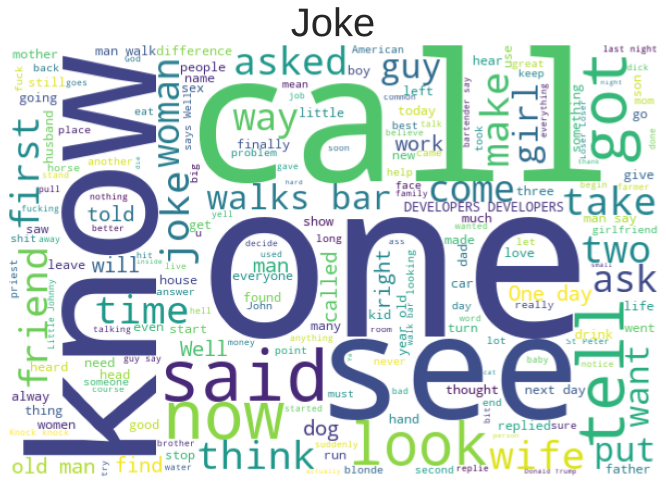

In [ ]:
draw_word_clouds(new_df)

* It is obvious that the text has not been processed and there are many words with high frequency.
* 'one', 'call', 'see' are the most frequent ones. 


# **Text Data Preprocessing**

In [93]:
text_col = 'joke'

## **Cleaning**

**Lower Casing**  
Lower casing is a common text preprocessing technique. The idea is to convert the input text into same casing format so that 'text', 'Text' and 'TEXT' are treated the same way.  

This is more helpful for text featurization techniques like frequency, tfidf as it helps to combine the same words together thereby reducing the duplication and get correct counts / tfidf values.  

**Some other parts like:** *html removal, extra whitespaces removal are also important.*

These may not be helpful when we do tasks like Part of Speech tagging (where proper casing gives some information about Nouns and so on) and Sentiment Analysis (where upper casing refers to anger and so on)  

In [94]:
def text_preprocessing(df, col):
    
    #remove html tags
    df[col] = df[col].apply(strip_html_tags)
    print('>>> REMOVE HTML TAGS <<<')
    print(df.head(1), '\n')

    #remove extra whitespaces
    df[col] = df[col].apply(remove_whitespace)
    print('>>> REMOVE EXTRA WHITESPACES <<<')
    print(data.head(1), '\n')

    #remove accented characters
    df[col] =  df[col].apply(remove_accented_chars)
    print('>>> REMOVE ACCENTED CHARS <<<')
    print(df.head(1), '\n')

    #expand contractions
    df[col] =  df[col].apply(expand_contractions)
    print('>>> EXPAND CONTRACTIONS <<<')
    print(data.head(1), '\n')


In [95]:
text_preprocessing(data, col='joke')

>>> REMOVE HTML TAGS <<<
        score                                               joke  score_std
id                                                                         
5tz52q      1  I hate how you cant even say black paint anymo...        0.0 

>>> REMOVE EXTRA WHITESPACES <<<
        score                                               joke  score_std
id                                                                         
5tz52q      1  I hate how you cant even say black paint anymo...        0.0 

>>> REMOVE ACCENTED CHARS <<<
        score                                               joke  score_std
id                                                                         
5tz52q      1  I hate how you cant even say black paint anymo...        0.0 

>>> EXPAND CONTRACTIONS <<<
        score                                               joke  score_std
id                                                                         
5tz52q      1  I hate how you cannot even 

**Removal of URLs**  
Next preprocessing step is to remove any URLs present in the data. Probably we might need to remove them for our further analysis.


1st of all, I check whether there are any URLs in dataset:

In [ ]:
for i in data['joke']:
    url = find_urls(i)
    if url == []:
      continue
    else:
      print(url)
      

['www.....That']
['http://www.youtube.com/watch?v=xaFZrxlPwWs),']
['http://m.imgur.com/x29gyvN', 'http://m.imgur.com/Q1iyUoT', 'http://m.imgur.com/hKRnGrT)', 'http://m.imgur.com/fqufGbK)']
['http://www.afterfeed.com/)?"']
['https://www.reddit.com/r/Punny/comments/4zob6u/tonight_the_world_egg_throwing_federation_host_a/?st=ISBQLINS&sh=8da1321d']
['www..."']
['http://www.merriam-webster.com/dictionary/hypocorism)."']
['https://techcrunch.com/2016/08/11/reddit-is-currently-experiencing-a-major-outage/']
['https://m.vk.com/wall-55955185_3834']
['https://en.m.wikipedia.org/wiki/Umami']
['http://www.afterfeed.com/story/detail/13350/14-epic-jokes-by-chandler-bing-from-friends-that-will-make-hole-in-your-belly)']
['http://www.dictionary.com/browse/evacuate)']
['http://instantrimshot.com/)']
['http://www.dictionary.com/browse/elope?s=t)']
['http://you-tricks.blogspot.com/2016/07/asian-doctor.html)']
['www..']
['https://pbs.twimg.com/media/CjVBbALUoAAb6r_.jpg)']
['www.curing-conjunctivitis.com.'

In [96]:
data['joke'] = data['joke'].apply(lambda text: remove_urls(text))
data.head(1)

,score,joke,score_std
id,,,
5tz52q,1,I hate how you cannot even say black paint any...,0.0


**Removal of numbers**  
* Here I delete only all the numbers that look like numbers, I will leave the written numbers for later.

In [97]:
data[text_col] = data[text_col].apply(lambda text: remove_numbers(text))
data.head(1)

,score,joke,score_std
id,,,
5tz52q,1,I hate how you cannot even say black paint any...,0.0


In [98]:
print('The number of duplicated data is:',sum(data.duplicated()))

The number of duplicated data is: 197


## **Same jokes have different scores:**   
Now I take the biggest score from a joke and set this value to all duplicates, then I delete duplicates.

In [101]:
print('The number of duplicated data is:',sum(data['joke'].duplicated()))

The number of duplicated data is: 3483


In [102]:
dupls = data[data['joke'].duplicated() == True]['joke'].unique()
dupls

array(['What did the leper say to the prostitute?. Keep the tip.',
       '!false. It is funny because it is true.',
       "What is Mexico's National Animal?. The drug mule.", ...,
       'What is the difference between ignorance and apathy?. Do not know, do not care.',
       'How do you know if your roommate is gay?. His dick tastes like shit.',
       'Why do they call it PMS?. Because mad cow disease was already taken'],
      dtype=object)

In [103]:
dupls = data[data['joke'].duplicated() == True]['joke'].unique()

for j in dupls:
  max_score = max(set(data[data['joke'] == j]['score']))
  joke_idxs = data[data['joke'] == j].index
  data['score'][joke_idxs] = max_score
  

In [105]:
data[data['joke'] == dupls[0]]

,score,joke,score_std
id,,,
5t6548,252,What did the leper say to the prostitute?. Kee...,0.500000
5swmk6,252,What did the leper say to the prostitute?. Kee...,1.500000
525zmr,252,What did the leper say to the prostitute?. Kee...,0.500000
4zzal9,252,What did the leper say to the prostitute?. Kee...,1.500000
4yf0xg,252,What did the leper say to the prostitute?. Kee...,1.414214
4tvbms,252,What did the leper say to the prostitute?. Kee...,2.000000
4t2ajn,252,What did the leper say to the prostitute?. Kee...,1.000000
48hd0j,252,What did the leper say to the prostitute?. Kee...,0.000000
46fpv4,252,What did the leper say to the prostitute?. Kee...,0.000000


Removal of duplicates

In [106]:
data.shape

(193710, 3)

In [107]:
data.drop_duplicates(inplace=True)
data.shape

(192379, 3)

### **Split 'score' in 4 quantiles (make 5 classes):**

In [109]:
data.groupby(pd.cut(data.score, np.percentile(data.score, [20, 40, 60, 80]), include_lowest=True)).mean()

,score,score_std
score,,
"(-0.001, 1.0]",0.239359,0.000000
"(1.0, 6.0]",3.492840,0.000000
"(6.0, 28.0]",14.022833,0.986055


In [110]:
def add_rank(data):
  if data == 0:
    return 0
  elif (data > 0) and( data <= 1):
    return 1 
  elif (data > 1)and (data <= 6):
    return 2
  elif (data > 6)and (data <= 28):
    return 3
  elif data > 28:
    return 4

In [111]:
data['rank'] = data['score'].apply(add_rank)

**Drop joke from one word:**

In [113]:
data['text_word_count'] = data['joke'].apply(lambda x: len(str(x).split()))
data.head(1)

,score,joke,score_std,rank,text_word_count
id,,,,,
5tz52q,1,I hate how you cannot even say black paint any...,0.0,1,22


In [116]:
data[data['text_word_count'] == 1]

,score,joke,rank,text_word_count
id,,,,
4s1ctb,0,.,0,1
4nfz1o,0,Gandalf.,0,1
4kq9zf,0,Bernie.,0,1
441t69,0,Lol.,0,1
3xunbs,0,-chan.,0,1
...,...,...,...,...
2a6jyn,0,PSm.,0,1
1p5dzb,0,Feminisim.,0,1
1nju7e,941,Congress.,4,1


In [117]:
data = data[data['text_word_count'] != 1]
data.drop(['score',	'text_word_count'], axis=1, inplace=True)

In [118]:
data.head()

,joke,rank
id,,
5tz52q,I hate how you cannot even say black paint any...,1
5tz4dd,What is the difference between a Jew in Nazi G...,0
5tz319,I recently went to America..... ...and being t...,0
5tz2wj,"Brian raises his hand and says, ""He is in Heav...",1
5tz1pc,You hear about the University book store worke...,0


In [119]:
data['rank'].value_counts()

0    60140
2    40704
4    38302
3    34199
1    18942
Name: rank, dtype: int64

### **Save preproc data:**

In [120]:
data.to_csv('/content/drive/My Drive/NLP_humor/data/jokes_dataset_MAIN_PREPROC.csv',
            sep=',',
            header=True, 
            index=True,
            encoding='utf-8')

### Load & Read data: 

In [121]:
data = pd.read_csv('/content/drive/My Drive/NLP_humor/data/jokes_dataset_MAIN_PREPROC.csv', 
                 sep=',', 
                 encoding='utf-8').set_index('id')

In [122]:
data.head()

,joke,rank
id,,
5tz52q,I hate how you cannot even say black paint any...,1
5tz4dd,What is the difference between a Jew in Nazi G...,0
5tz319,I recently went to America..... ...and being t...,0
5tz2wj,"Brian raises his hand and says, ""He is in Heav...",1
5tz1pc,You hear about the University book store worke...,0


In [123]:
data.dropna(inplace=True)

In [124]:
data.isna().sum()

joke    0
rank    0
dtype: int64